In [1]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 38.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.7 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.5 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.7 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 24.1 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 13.5 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 8.3 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 23.5 MB/s eta 0:00:00:00:0100:01
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.9.41
    Uninstalling nvidia-nvjitlink-cu12-12.9.41:
      Successfully uninstalled nvidia-nvjitlink-cu12-12.9.41
  Attempting uninstall: nvidia-curand-cu12
    Found existing ins

In [2]:
import pandas as pd
import os
import numpy as np
import shutil
import yaml
import matplotlib.pyplot as plt
import random
import cv2

from sklearn import model_selection
from tqdm import tqdm
from glob import glob

In [3]:
size = 512
TRAIN_LABELS_PATH = './vinbigdata/labels/train'
VAL_LABELS_PATH = './vinbigdata/labels/val'
TRAIN_IMAGES_PATH = './vinbigdata/images/train' #12000
VAL_IMAGES_PATH = './vinbigdata/images/val' #3000
External_DIR = f'../input/vinbigdata-{size}-image-dataset/vinbigdata/train' # 15000
os.makedirs(TRAIN_LABELS_PATH, exist_ok = True)
os.makedirs(VAL_LABELS_PATH, exist_ok = True)
os.makedirs(TRAIN_IMAGES_PATH, exist_ok = True)
os.makedirs(VAL_IMAGES_PATH, exist_ok = True)

In [4]:
original_df = pd.read_csv('../input/vinbigdata-chest-xray-abnormalities-detection/train.csv')
number_of_imageids = len(original_df['image_id'].values)
print(f'Total number of image_ids (train + validation) {number_of_imageids}')

number_of_images = len(os.listdir('../input/vinbigdata-chest-xray-abnormalities-detection/train'))
print(f'Total number of images (train + validation) {number_of_images}')

number_of_labels = len(os.listdir('../input/vinbigdata-yolo-labels-dataset/labels'))
print(f'Total number of labels (train + validation) {number_of_labels}')

Total number of image_ids (train + validation) 67914
Total number of images (train + validation) 15000
Total number of labels (train + validation) 15000


In [5]:
import os
import cv2
import numpy as np
import pydicom
import multiprocessing
from tqdm import tqdm
from skimage import exposure

def dicom2array(path, voi_lut=True, fix_monochrome=True):
    dicom = pydicom.read_file(path)
    if voi_lut:
        data = apply_voi_lut(dicom.pixel_array, dicom)
    else:
        data = dicom.pixel_array
    if fix_monochrome and dicom.PhotometricInterpretation == "MONOCHROME1":
        data = np.amax(data) - data
    data = data - np.min(data)
    data = data / np.max(data)
    data = (data * 255).astype(np.uint8)
    return data

def process_image(dicom_path_output_dir):
    dicom_path, output_dir = dicom_path_output_dir
    file_name = os.path.splitext(os.path.basename(dicom_path))[0]
    image_array = dicom2array(dicom_path)
    equalized_image = exposure.equalize_hist(image_array)
    equalized_image = (equalized_image * 255).astype(np.uint8)
    cv2.imwrite(os.path.join(output_dir, f"{file_name}.jpeg"), equalized_image)

def saving_image(output_dir, dicom_path_list):
    os.makedirs(output_dir, exist_ok=True)
    dicom_path_output_dir_list = [(path, output_dir) for path in dicom_path_list]

    # Use multiprocessing Pool for parallel processing
    with multiprocessing.Pool() as pool:
        list(tqdm(pool.imap(process_image, dicom_path_output_dir_list), total=len(dicom_path_list), desc="Processing Images"))

In [6]:
df = pd.read_csv('/kaggle/input/vinbigdata-chest-xray-abnormalities-detection/train.csv')
number_of_images = len(df['image_id'].values)
print(f'Total number of image ids (train + validation) {number_of_images}')

df = df[df.class_id!=14].reset_index(drop = True)
number_of_images = len(df['image_id'].values)
print(f'Total number of image ids after dropping normal images (train + validation) {number_of_images}')

df.head()

Total number of image ids (train + validation) 67914
Total number of image ids after dropping normal images (train + validation) 36096


,image_id,class_name,class_id,rad_id,x_min,y_min,x_max,y_max
0,9a5094b2563a1ef3ff50dc5c7ff71345,Cardiomegaly,3,R10,691.0,1375.0,1653.0,1831.0
1,051132a778e61a86eb147c7c6f564dfe,Aortic enlargement,0,R10,1264.0,743.0,1611.0,1019.0
2,1c32170b4af4ce1a3030eb8167753b06,Pleural thickening,11,R9,627.0,357.0,947.0,433.0
3,0c7a38f293d5f5e4846aa4ca6db4daf1,ILD,5,R17,1347.0,245.0,2188.0,2169.0
4,47ed17dcb2cbeec15182ed335a8b5a9e,Nodule/Mass,8,R9,557.0,2352.0,675.0,2484.0


In [7]:
df = df.drop(columns=['class_name', 'rad_id', 'x_min', 'x_max', 'y_min', 'y_max',  'class_id']) # we only need image ids, labels are pre-made
df.head()

,image_id
0,9a5094b2563a1ef3ff50dc5c7ff71345
1,051132a778e61a86eb147c7c6f564dfe
2,1c32170b4af4ce1a3030eb8167753b06
3,0c7a38f293d5f5e4846aa4ca6db4daf1
4,47ed17dcb2cbeec15182ed335a8b5a9e


In [8]:
df_train, df_valid = model_selection.train_test_split(df, test_size=0.15, random_state=42, shuffle=True)

In [9]:
number_of_images = len(df_train['image_id'].values)
print(f'Total number of training image_ids {number_of_images}')

number_of_images = len(df_valid['image_id'].values)
print(f'Total number of validation image_ids {number_of_images}')


Total number of training image_ids 30681
Total number of validation image_ids 5415


In [10]:
# need to delete duplicate image ids, len(labels) should be equal len(df.imageids.values), 

In [11]:
print(f'Total number of training images {len(df_train.image_id.unique())}')
print(f'Total number of validation images {len(df_valid.image_id.unique())}')

Total number of training images 4392
Total number of validation images 2966


In [12]:
def preproccess_data(df, labels_path, images_path):
    for img_id in tqdm(df.image_id.unique()):
        shutil.copy(os.path.join('../input/vinbigdata-yolo-labels-dataset/labels', f"{img_id}"+'.txt'), labels_path)
        shutil.copy(os.path.join(f'/kaggle/input/vinbigdata-{size}-image-dataset/vinbigdata/train', f"{img_id}.png"), images_path)

In [13]:
preproccess_data(df_train, TRAIN_LABELS_PATH, TRAIN_IMAGES_PATH)
preproccess_data(df_valid, VAL_LABELS_PATH, VAL_IMAGES_PATH)

100%|██████████| 2966/2966 [00:05<00:00, 541.28it/s]


In [14]:
# check that data was preprocessed correctly
print(len(os.listdir(TRAIN_LABELS_PATH)))
print(len(os.listdir(TRAIN_IMAGES_PATH)))

print(len(os.listdir(VAL_LABELS_PATH)))
print(len(os.listdir(VAL_IMAGES_PATH)))

4392
4392
2966
2966


In [15]:
# credit / source https://www.kaggle.com/awsaf49/vinbigdata-cxr-ad-yolov5-14-class-train
classes = [ 'Aortic enlargement',
            'Atelectasis',
            'Calcification',
            'Cardiomegaly',
            'Consolidation',
            'ILD',
            'Infiltration',
            'Lung Opacity',
            'Nodule/Mass',
            'Other lesion',
            'Pleural effusion',
            'Pleural thickening',
            'Pneumothorax',
            'Pulmonary fibrosis']

data = dict(
    train =  '../vinbigdata/images/train',
    val   =  '../vinbigdata/images/val',
    nc    = 14,
    names = classes
    )

with open('/kaggle/working/vinbigdata.yaml', 'w') as outfile:
    yaml.dump(data, outfile, default_flow_style=False)

f = open(os.path.join( os.getcwd() , 'vinbigdata.yaml'), 'r')
print('\nyaml:')
print(f.read())


yaml:
names:
- Aortic enlargement
- Atelectasis
- Calcification
- Cardiomegaly
- Consolidation
- ILD
- Infiltration
- Lung Opacity
- Nodule/Mass
- Other lesion
- Pleural effusion
- Pleural thickening
- Pneumothorax
- Pulmonary fibrosis
nc: 14
train: ../vinbigdata/images/train
val: ../vinbigdata/images/val



In [16]:
import os
from ultralytics import YOLO  
os.environ["WANDB_MODE"] = "dryrun"

model = YOLO('yolo11l.pt')  

model.train(
    data='./vinbigdata.yaml',  
    imgsz=640,                
    epochs=100,               
    device=0                 
)

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 49.0M/49.0M [00:00<00:00, 343MB/s]


Ultralytics 8.3.155 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=./vinbigdata.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11l.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.0, pretrained=True, profil

100%|██████████| 755k/755k [00:00<00:00, 39.5MB/s]


Overriding model.yaml nc=80 with nc=14

                   from  n    params  module                                       arguments                     
  0                  -1  1      1856  ultralytics.nn.modules.conv.Conv             [3, 64, 3, 2]                 
  1                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  2                  -1  2    173824  ultralytics.nn.modules.block.C3k2            [128, 256, 2, True, 0.25]     
  3                  -1  1    590336  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2]              
  4                  -1  2    691712  ultralytics.nn.modules.block.C3k2            [256, 512, 2, True, 0.25]     
  5                  -1  1   2360320  ultralytics.nn.modules.conv.Conv             [512, 512, 3, 2]              
  6                  -1  2   2234368  ultralytics.nn.modules.block.C3k2            [512, 512, 2, True]           
  7                  -1  1   2360320  ultralytic

100%|██████████| 5.35M/5.35M [00:00<00:00, 71.8MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1863.6±1259.2 MB/s, size: 140.0 KB)


train: Scanning /kaggle/working/vinbigdata/labels/train... 4392 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4392/4392 [00:06<00:00, 708.58it/s]

train: New cache created: /kaggle/working/vinbigdata/labels/train.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1473.1±785.0 MB/s, size: 119.0 KB)


val: Scanning /kaggle/working/vinbigdata/labels/val... 2966 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2966/2966 [00:04<00:00, 680.89it/s]


val: New cache created: /kaggle/working/vinbigdata/labels/val.cache
Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000556, momentum=0.9) with parameter groups 167 weight(decay=0.0), 174 weight(decay=0.0005), 173 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      10.1G      1.932      2.788      1.911        118        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:04<00:00,  1.45it/s]


                   all       2966      27483      0.279      0.173      0.131     0.0625

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      10.4G      1.757      2.184      1.772         91        640: 100%|██████████| 275/275 [03:37<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.48it/s]


                   all       2966      27483      0.338      0.175      0.146     0.0717

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      10.3G      1.735      2.128      1.757         87        640: 100%|██████████| 275/275 [03:35<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:03<00:00,  1.47it/s]


                   all       2966      27483      0.228      0.229      0.167     0.0799

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      10.4G      1.731      2.098      1.747        128        640: 100%|██████████| 275/275 [03:34<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:03<00:00,  1.46it/s]


                   all       2966      27483      0.265      0.256      0.189     0.0895

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      10.3G      1.681      2.031      1.716         84        640: 100%|██████████| 275/275 [03:34<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.49it/s]


                   all       2966      27483      0.415      0.218      0.189     0.0884

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      10.3G      1.674      1.992      1.696        106        640: 100%|██████████| 275/275 [03:34<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.49it/s]


                   all       2966      27483      0.339      0.263      0.216      0.102

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      10.3G      1.643      1.944      1.666         96        640: 100%|██████████| 275/275 [03:35<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.48it/s]


                   all       2966      27483      0.322      0.276      0.217      0.102

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      10.4G      1.653      1.946      1.666        146        640: 100%|██████████| 275/275 [03:34<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.49it/s]


                   all       2966      27483      0.343      0.248      0.224      0.107

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      10.3G      1.627      1.893      1.636         70        640: 100%|██████████| 275/275 [03:34<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.49it/s]


                   all       2966      27483      0.327      0.291       0.24      0.116

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      10.3G      1.611      1.873      1.626         81        640: 100%|██████████| 275/275 [03:34<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.49it/s]


                   all       2966      27483      0.344      0.297       0.25      0.121

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      10.4G      1.599      1.844      1.618        120        640: 100%|██████████| 275/275 [03:34<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.49it/s]


                   all       2966      27483      0.358      0.311      0.279      0.135

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      10.4G      1.581      1.814      1.602        123        640: 100%|██████████| 275/275 [03:34<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.50it/s]


                   all       2966      27483      0.377      0.288      0.264      0.129

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      10.4G      1.593      1.828      1.621         60        640: 100%|██████████| 275/275 [03:34<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.50it/s]


                   all       2966      27483      0.331      0.291      0.254      0.125

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      10.3G      1.576      1.794        1.6         97        640: 100%|██████████| 275/275 [03:34<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.49it/s]


                   all       2966      27483      0.351      0.331      0.285      0.138

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      10.4G       1.56      1.781      1.584         78        640: 100%|██████████| 275/275 [03:34<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.49it/s]


                   all       2966      27483      0.409      0.324      0.306      0.149

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      10.5G      1.565      1.765      1.578        127        640: 100%|██████████| 275/275 [03:34<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.49it/s]


                   all       2966      27483      0.395      0.329      0.303      0.149

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      10.3G      1.545      1.738      1.566         82        640: 100%|██████████| 275/275 [03:33<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:03<00:00,  1.47it/s]


                   all       2966      27483      0.347      0.331      0.273      0.134

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      10.4G      1.538      1.728      1.562         89        640: 100%|██████████| 275/275 [03:34<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.48it/s]


                   all       2966      27483       0.38      0.362       0.31      0.153

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      10.3G      1.548      1.741      1.576         96        640: 100%|██████████| 275/275 [03:34<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.49it/s]


                   all       2966      27483      0.368      0.343      0.289      0.144

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      10.3G      1.537      1.734      1.562         49        640: 100%|██████████| 275/275 [03:34<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.50it/s]


                   all       2966      27483      0.426      0.345      0.337      0.166

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      10.3G      1.536      1.721      1.564        120        640: 100%|██████████| 275/275 [03:34<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.49it/s]


                   all       2966      27483       0.38      0.335      0.304      0.153

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      10.4G      1.521      1.705      1.557        107        640: 100%|██████████| 275/275 [03:34<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.49it/s]


                   all       2966      27483      0.419      0.356      0.328      0.162

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      10.3G       1.52      1.696      1.546        147        640: 100%|██████████| 275/275 [03:33<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.49it/s]


                   all       2966      27483      0.398      0.349      0.324      0.162

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      10.4G      1.513      1.677      1.538        113        640: 100%|██████████| 275/275 [03:34<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.50it/s]


                   all       2966      27483      0.415      0.335       0.32       0.16

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      10.3G      1.518      1.684      1.551         86        640: 100%|██████████| 275/275 [03:34<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.50it/s]


                   all       2966      27483      0.421      0.365      0.348      0.173

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      10.4G      1.511      1.659      1.534        105        640: 100%|██████████| 275/275 [03:34<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.49it/s]


                   all       2966      27483      0.386      0.366       0.33      0.169

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      10.3G      1.502      1.658      1.536        137        640: 100%|██████████| 275/275 [03:34<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.49it/s]


                   all       2966      27483      0.418      0.371      0.347      0.174

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      10.3G      1.513      1.671      1.535        103        640: 100%|██████████| 275/275 [03:34<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.49it/s]


                   all       2966      27483      0.408      0.379      0.346      0.175

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      10.3G      1.504      1.653      1.527        130        640: 100%|██████████| 275/275 [03:35<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.49it/s]


                   all       2966      27483      0.435      0.375      0.364      0.188

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      10.3G      1.479      1.631      1.517        147        640: 100%|██████████| 275/275 [03:35<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.50it/s]


                   all       2966      27483      0.434      0.383      0.368      0.188

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      10.3G      1.487      1.616      1.519        107        640: 100%|██████████| 275/275 [03:34<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.50it/s]


                   all       2966      27483      0.436      0.364      0.351      0.179

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      10.4G      1.479      1.627       1.52        119        640: 100%|██████████| 275/275 [03:35<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.50it/s]


                   all       2966      27483      0.467      0.382      0.386        0.2

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      10.3G      1.476      1.604      1.503         50        640: 100%|██████████| 275/275 [03:34<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.49it/s]


                   all       2966      27483      0.441      0.379      0.371       0.19

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      10.3G      1.471      1.616      1.505        111        640: 100%|██████████| 275/275 [03:35<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.50it/s]


                   all       2966      27483      0.411       0.38      0.355      0.185

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      10.4G      1.473      1.599        1.5        168        640: 100%|██████████| 275/275 [03:34<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.50it/s]


                   all       2966      27483      0.455      0.396      0.393      0.204

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      10.5G      1.471      1.589      1.504         85        640: 100%|██████████| 275/275 [03:35<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.50it/s]


                   all       2966      27483      0.452      0.407      0.392      0.205

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      10.4G      1.456      1.574      1.496         99        640: 100%|██████████| 275/275 [03:35<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.50it/s]


                   all       2966      27483      0.452      0.395      0.382        0.2

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      10.4G      1.453       1.57      1.494        131        640: 100%|██████████| 275/275 [03:35<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.49it/s]


                   all       2966      27483      0.458      0.398       0.39      0.204

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      10.3G       1.45      1.551      1.492        105        640: 100%|██████████| 275/275 [03:35<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.50it/s]


                   all       2966      27483      0.467      0.403        0.4      0.212

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      10.4G      1.453      1.551      1.485         86        640: 100%|██████████| 275/275 [03:35<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.50it/s]


                   all       2966      27483      0.478      0.417      0.412      0.219

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      10.3G      1.445       1.55      1.484        112        640: 100%|██████████| 275/275 [03:35<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.50it/s]


                   all       2966      27483      0.482      0.411      0.417      0.223

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      10.4G       1.44      1.543      1.476        150        640: 100%|██████████| 275/275 [03:35<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.50it/s]


                   all       2966      27483      0.468      0.415      0.411       0.22

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      10.3G      1.439       1.55      1.491         92        640: 100%|██████████| 275/275 [03:34<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.49it/s]


                   all       2966      27483      0.467      0.418      0.413      0.221

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      10.3G      1.437      1.538      1.479        102        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.51it/s]


                   all       2966      27483      0.487      0.427      0.429      0.232

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      10.3G      1.435      1.525      1.478         54        640: 100%|██████████| 275/275 [03:35<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.50it/s]


                   all       2966      27483      0.499      0.422      0.436      0.234

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      10.4G      1.424      1.511      1.474        126        640: 100%|██████████| 275/275 [03:35<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.50it/s]


                   all       2966      27483      0.465      0.414      0.411       0.22

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      10.3G       1.42      1.499      1.464         94        640: 100%|██████████| 275/275 [03:35<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.50it/s]


                   all       2966      27483      0.484      0.425      0.428      0.229

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      10.4G      1.419      1.512      1.466         79        640: 100%|██████████| 275/275 [03:35<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.50it/s]


                   all       2966      27483      0.491      0.408      0.415      0.223

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      10.3G      1.412      1.483      1.452        103        640: 100%|██████████| 275/275 [03:35<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.50it/s]


                   all       2966      27483      0.495      0.438      0.439      0.239

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      10.3G      1.416      1.487      1.457        127        640: 100%|██████████| 275/275 [03:35<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.50it/s]


                   all       2966      27483      0.515      0.432       0.45      0.247

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      10.3G      1.407      1.484       1.46        102        640: 100%|██████████| 275/275 [03:34<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.50it/s]


                   all       2966      27483      0.508      0.442      0.455       0.25

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      10.3G      1.409      1.471       1.46        106        640: 100%|██████████| 275/275 [03:35<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.50it/s]


                   all       2966      27483       0.53      0.443      0.463      0.257

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      10.3G      1.406      1.472      1.453         92        640: 100%|██████████| 275/275 [03:35<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.50it/s]


                   all       2966      27483      0.533      0.444      0.465      0.256

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      10.3G       1.39      1.463      1.441         90        640: 100%|██████████| 275/275 [03:35<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.50it/s]


                   all       2966      27483      0.532       0.45      0.471      0.262

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      10.4G      1.388      1.448      1.442         49        640: 100%|██████████| 275/275 [03:35<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.50it/s]


                   all       2966      27483      0.519      0.455      0.465       0.26

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      10.4G      1.383      1.446      1.443         79        640: 100%|██████████| 275/275 [03:35<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.50it/s]


                   all       2966      27483      0.532      0.445      0.472      0.265

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      10.3G      1.382      1.449      1.441         73        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.50it/s]


                   all       2966      27483      0.553      0.452      0.484      0.274

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      10.4G      1.384      1.432      1.434         81        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.50it/s]


                   all       2966      27483      0.537      0.457      0.481      0.271

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      10.4G      1.385       1.43      1.441        146        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.50it/s]


                   all       2966      27483      0.524      0.456      0.471      0.267

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      10.3G      1.376      1.432      1.436        104        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.51it/s]


                   all       2966      27483      0.551      0.461      0.497      0.284

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      10.3G      1.359      1.396      1.423        156        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.50it/s]


                   all       2966      27483      0.561       0.47      0.505       0.29

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      10.4G      1.364      1.401      1.428         96        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.50it/s]


                   all       2966      27483      0.566      0.474      0.509      0.292

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      10.3G      1.361       1.39      1.417        129        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.50it/s]


                   all       2966      27483      0.548      0.457      0.492      0.283

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      10.3G      1.359      1.395       1.42         63        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.51it/s]


                   all       2966      27483      0.569       0.48      0.517      0.301

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      10.3G      1.344      1.366      1.407        127        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.51it/s]


                   all       2966      27483      0.568      0.482      0.516        0.3

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      10.3G      1.343      1.375      1.412        115        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.51it/s]


                   all       2966      27483      0.583      0.481      0.522      0.307

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      10.3G      1.336      1.355      1.401        101        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.51it/s]


                   all       2966      27483      0.574      0.486      0.526      0.309

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      10.3G      1.339      1.352      1.409         90        640: 100%|██████████| 275/275 [03:37<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.50it/s]


                   all       2966      27483      0.588       0.48      0.526      0.311

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      10.3G      1.331      1.348      1.398         76        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.50it/s]


                   all       2966      27483      0.604      0.486      0.537      0.319

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      10.4G      1.338      1.336      1.407         71        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.50it/s]


                   all       2966      27483        0.6      0.494      0.547      0.327

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      10.3G      1.325      1.327      1.398         95        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.51it/s]


                   all       2966      27483      0.592      0.497      0.548      0.328

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      10.4G       1.32      1.326      1.397         96        640: 100%|██████████| 275/275 [03:37<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.51it/s]


                   all       2966      27483      0.604      0.496      0.546      0.326

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      10.4G      1.313      1.316      1.391         76        640: 100%|██████████| 275/275 [03:37<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.51it/s]


                   all       2966      27483      0.609      0.503      0.556      0.334

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      10.4G      1.313       1.32      1.397         79        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.51it/s]


                   all       2966      27483      0.617      0.502      0.562      0.339

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      10.4G      1.311      1.304      1.383        108        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.50it/s]


                   all       2966      27483      0.616      0.512      0.563       0.34

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      10.5G      1.302      1.286      1.383         94        640: 100%|██████████| 275/275 [03:37<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.50it/s]


                   all       2966      27483      0.624      0.517      0.573      0.349

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      10.3G      1.298      1.292       1.38         71        640: 100%|██████████| 275/275 [03:37<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.51it/s]


                   all       2966      27483      0.622       0.52      0.575      0.351

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      10.5G      1.292      1.289      1.378         83        640: 100%|██████████| 275/275 [03:37<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.50it/s]


                   all       2966      27483      0.637      0.513      0.574      0.354

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      10.4G      1.288      1.272      1.377         97        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.51it/s]


                   all       2966      27483      0.639      0.517      0.579      0.357

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      10.4G      1.283      1.265      1.376         47        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.51it/s]


                   all       2966      27483      0.643      0.521      0.586      0.362

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      10.4G      1.281      1.268      1.371         72        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.51it/s]


                   all       2966      27483      0.648      0.518      0.588      0.363

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      10.4G       1.28      1.267      1.367        110        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.51it/s]


                   all       2966      27483      0.658      0.523      0.592      0.367

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      10.3G      1.272      1.243       1.36        114        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.51it/s]


                   all       2966      27483      0.657      0.522      0.591       0.37

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      10.4G      1.264      1.229      1.353        114        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.51it/s]


                   all       2966      27483      0.649       0.53      0.595      0.372

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      10.3G      1.261      1.218      1.353        110        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.51it/s]


                   all       2966      27483      0.663      0.528      0.597      0.376

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      10.4G      1.257      1.225      1.355         74        640: 100%|██████████| 275/275 [03:37<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.51it/s]


                   all       2966      27483      0.661      0.526      0.598      0.378

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      10.3G      1.254      1.214      1.358         86        640: 100%|██████████| 275/275 [03:37<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.52it/s]


                   all       2966      27483      0.675      0.531      0.609      0.388

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      10.4G      1.249       1.22      1.357         72        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.52it/s]


                   all       2966      27483      0.673      0.538      0.614      0.392

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      10.3G      1.249      1.208      1.352        124        640: 100%|██████████| 275/275 [03:37<00:00,  1.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.51it/s]


                   all       2966      27483      0.678      0.533      0.612      0.391

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      10.4G      1.239      1.199      1.345         60        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.51it/s]


                   all       2966      27483      0.681      0.537      0.616      0.395
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      10.4G      1.238      1.137      1.411         64        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.50it/s]


                   all       2966      27483      0.681      0.544      0.618      0.396

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      10.5G      1.224      1.117      1.404         79        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.49it/s]


                   all       2966      27483      0.686       0.55      0.625      0.403

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      10.4G      1.215      1.097      1.398         56        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.50it/s]


                   all       2966      27483      0.696      0.548      0.629      0.407

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      10.5G      1.204      1.087      1.397         48        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.50it/s]


                   all       2966      27483      0.697      0.548      0.629      0.407

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      10.3G      1.201      1.076      1.382         80        640: 100%|██████████| 275/275 [03:37<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.50it/s]


                   all       2966      27483      0.705       0.55      0.633      0.411

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      10.5G      1.197      1.071      1.385         66        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.50it/s]


                   all       2966      27483      0.701      0.555      0.636      0.415

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      10.3G      1.189      1.069      1.384         74        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.50it/s]


                   all       2966      27483      0.701      0.553      0.637      0.415

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      10.4G       1.19      1.058      1.382         73        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.50it/s]


                   all       2966      27483      0.707      0.549      0.638      0.418

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      10.4G      1.179      1.053      1.376         57        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.51it/s]


                   all       2966      27483      0.712      0.553       0.64       0.42

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      10.5G      1.174      1.046      1.371         59        640: 100%|██████████| 275/275 [03:36<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:01<00:00,  1.50it/s]


                   all       2966      27483      0.705      0.558      0.641      0.422

100 epochs completed in 7.776 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 51.2MB
Optimizer stripped from runs/detect/train/weights/best.pt, 51.2MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.155 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11l summary (fused): 190 layers, 25,290,106 parameters, 0 gradients, 86.6 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 93/93 [01:02<00:00,  1.49it/s]
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all       2966      27483      0.702      0.558      0.641      0.422
    Aortic enlargement       2068       4751      0.833      0.595      0.725      0.508
           Atelectasis        155        239      0.632      0.582      0.654      0.427
         Calcification        341        782      0.611      0.486      0.543      0.335
          Cardiomegaly       1537       3602       0.88      0.588      0.746      0.558
         Consolidation        289        462      0.706      0.652       0.71      0.505
                   ILD        299        774      0.627      0.642      0.667      0.456
          Infiltration        485       1027      0.699       0.55      0.637      0.429
          Lung Opacity       1044       2058      0.698      0.619      0.687      0.457
           Nodule/Mass        641       2209      0.708      0.444      0.512      0.321
          Other lesion        873       1756      0.691      0.543       0.63      0.407
      Pleural effusio

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7f819cec1e50>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.0

In [17]:
test_df = pd.read_csv(f'/kaggle/input/vinbigdata-{size}-image-dataset/vinbigdata/test.csv')

In [18]:
test_dir = f'/kaggle/input/vinbigdata-{size}-image-dataset/vinbigdata/test'
os.listdir('/kaggle/working/runs/detect/train/weights/')

['best.pt', 'last.pt']

In [19]:
weights_dir = "/kaggle/working/runs/detect/train/weights/best.pt"  # Trọng số mô hình đã huấn luyện

model = YOLO(weights_dir)

results = model.predict(
    source=test_dir,
    imgsz=640,
    conf=0.005,
    iou=0.45,
    save_txt=True,
    save_conf=True,
    project="/kaggle/working/runs/detect",  
    name="exp",                            
    exist_ok=True,                         
    save=True,
    verbose=False# Lưu ảnh với bounding box
)

WARNING ⚠️ 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

Results saved to /kaggle/working/runs/detect/exp
2993 labels saved to /kaggle/working/runs/detect/exp/labels


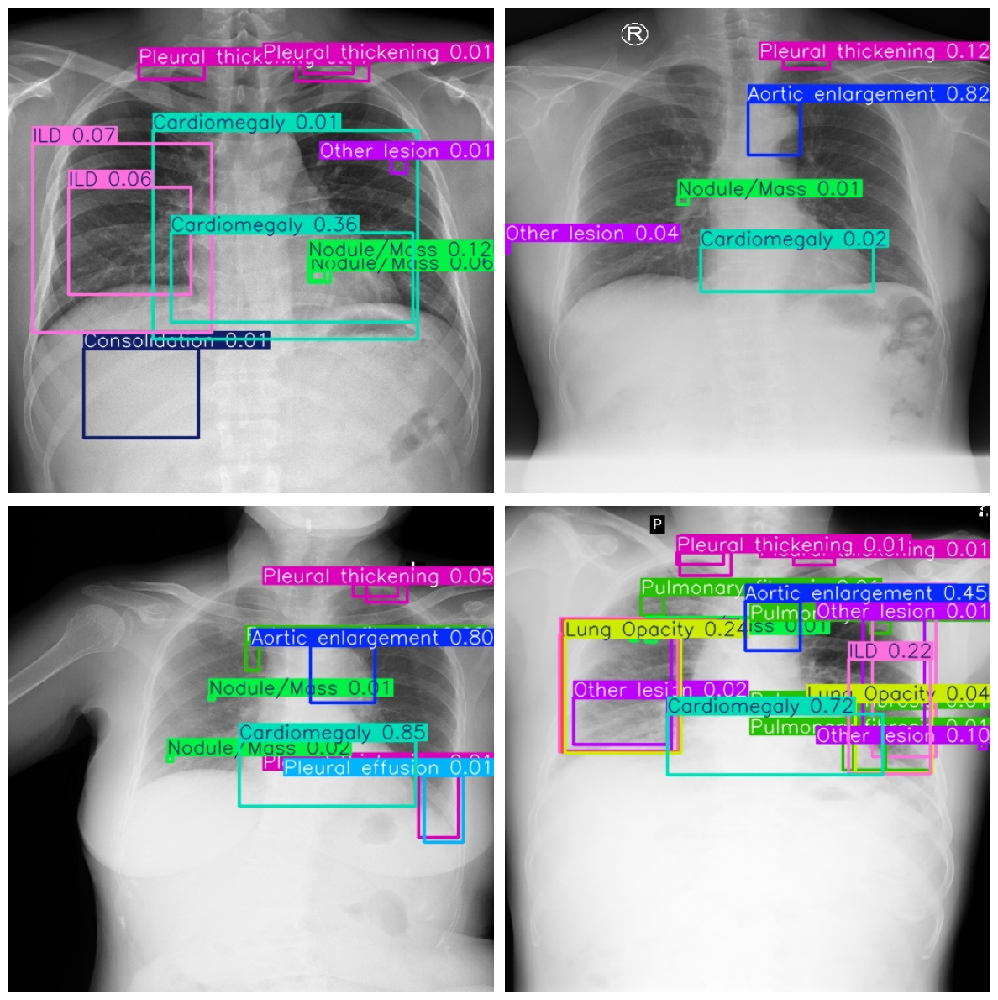

In [20]:
import os
import matplotlib.pyplot as plt
from PIL import Image

# 1. Point to your YOLO output directory
output_dir = "/kaggle/working/runs/detect/exp"

# 2. Gather all .jpg/.png files
images = [
    os.path.join(output_dir, f)
    for f in sorted(os.listdir(output_dir))
    if f.lower().endswith((".jpg", ".png"))
]

# 3. Display the first 4 results in a 2×2 grid
plt.figure(figsize=(12, 12))
for i, img_path in enumerate(images[:4]):
    img = Image.open(img_path)
    plt.subplot(2, 2, i + 1)
    plt.imshow(img)
    plt.axis("off")
plt.tight_layout()
plt.show()


In [21]:
# ─── Cell: Validation-Batch Visualization ───
# Author: mo

import os
import re
from typing import List, Tuple, Optional
from PIL import Image
import matplotlib.pyplot as plt

def get_val_batch_pairs(dir_path: str) -> List[Tuple[str, str]]:
    label_regex = re.compile(r"val_batch(\d+)_labels\.\w+$")
    pred_regex  = re.compile(r"val_batch(\d+)_pred\.\w+$")
    labels, preds = {}, {}

    for root, _, files in os.walk(dir_path):
        for fname in files:
            full = os.path.join(root, fname)
            m = label_regex.match(fname)
            if m:
                labels[int(m.group(1))] = full
            m = pred_regex.match(fname)
            if m:
                preds[int(m.group(1))] = full

    idxs = sorted(set(labels) & set(preds))
    if not idxs:
        raise ValueError(f"No pairs found in {dir_path}")
    return [(labels[i], preds[i]) for i in idxs]

def show_val_batch_comparisons(
    dir_path: str,
    max_batches: Optional[int] = None,
    save_path: Optional[str] = None
) -> None:
    pairs = get_val_batch_pairs(dir_path)
    if max_batches is not None:
        pairs = pairs[:max_batches]
    n = len(pairs)
    fig, axs = plt.subplots(n, 2, figsize=(12, 4*n), squeeze=False)

    for i, (lab, pred) in enumerate(pairs):
        for j, (path, title) in enumerate([(lab, "Labels"), (pred, "Predictions")]):
            axs[i][j].imshow(Image.open(path))
            axs[i][j].set_title(f"Batch {i}: {title}")
            axs[i][j].axis("off")

    plt.tight_layout()
    if save_path:
        plt.savefig(save_path, bbox_inches="tight")
        print(f"Saved to {save_path}")
    plt.show()

# ─── End of Cell ───────────────────────────


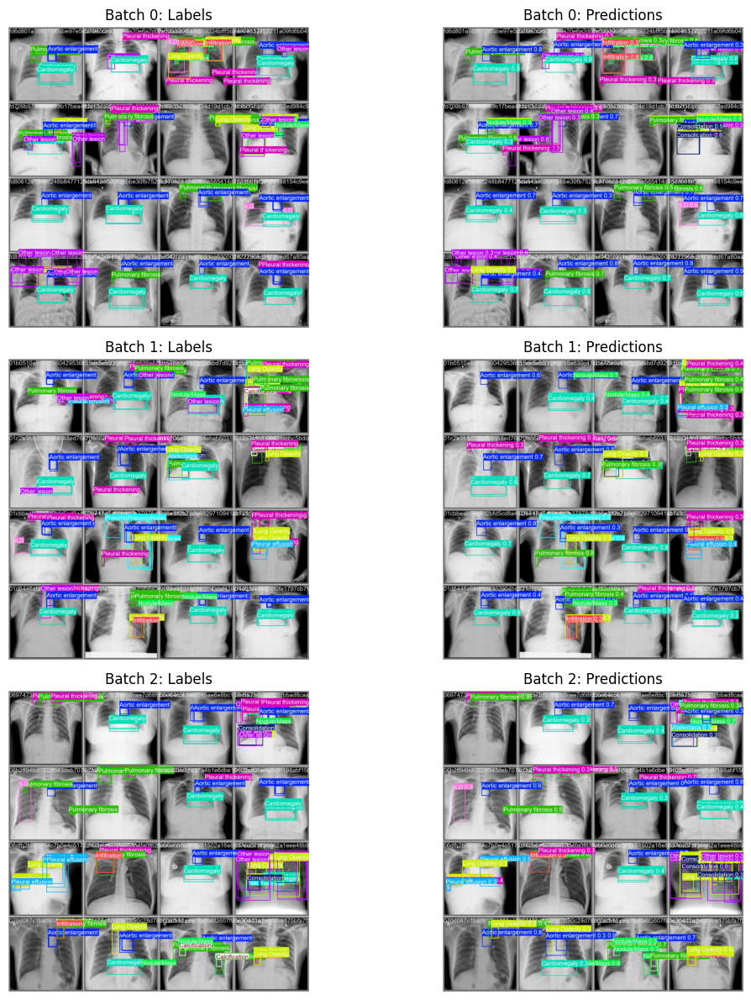

In [22]:
# Show up to the first 6 validation batches:
show_val_batch_comparisons(
    dir_path="/kaggle/working/runs/detect/train",
    max_batches=6
)


In [23]:
# ─── Cell: Validation-Batch Visualization (Enlarged) ───
# Author: mo

import os
import re
from typing import List, Tuple, Optional
from PIL import Image
import matplotlib.pyplot as plt

def get_val_batch_pairs(dir_path: str) -> List[Tuple[str, str]]:
    label_regex = re.compile(r"val_batch(\d+)_labels\.\w+$")
    pred_regex  = re.compile(r"val_batch(\d+)_pred\.\w+$")
    labels, preds = {}, {}

    for root, _, files in os.walk(dir_path):
        for fname in files:
            full = os.path.join(root, fname)
            m = label_regex.match(fname)
            if m:
                labels[int(m.group(1))] = full
            m = pred_regex.match(fname)
            if m:
                preds[int(m.group(1))] = full

    idxs = sorted(set(labels) & set(preds))
    if not idxs:
        raise ValueError(f"No pairs found in {dir_path}")
    return [(labels[i], preds[i]) for i in idxs]

def show_val_batch_comparisons(
    dir_path: str,
    max_batches: Optional[int] = None,
    save_path: Optional[str] = None,
    dpi: int = 150,
    width_per_image: float = 8.0,
    height_per_image: float = 6.0
) -> None:
    """
    Display enlarged validation batch label vs. prediction comparisons.

    Args:
        dir_path (str): Directory containing validation batch images.
        max_batches (Optional[int]): Limit display to first N batches.
        save_path (Optional[str]): Filepath to save the figure (optional).
        dpi (int): Dots-per-inch of the resulting figure.
        width_per_image (float): Width in inches of each subplot.
        height_per_image (float): Height in inches of each subplot.
    """
    pairs = get_val_batch_pairs(dir_path)
    if max_batches is not None:
        pairs = pairs[:max_batches]
    n = len(pairs)
    if n == 0:
        raise ValueError("No batches to display after filtering.")

    # Compute total figure size
    fig_width  = width_per_image * 2       # two columns
    fig_height = height_per_image * n      # one row per batch

    fig, axs = plt.subplots(
        nrows=n,
        ncols=2,
        figsize=(fig_width, fig_height),
        squeeze=False,
        dpi=dpi
    )

    for i, (lab, pred) in enumerate(pairs):
        for j, (path, title) in enumerate([(lab, "Labels"), (pred, "Predictions")]):
            axs[i][j].imshow(Image.open(path))
            axs[i][j].set_title(f"Batch {i}: {title}", fontsize=16)
            axs[i][j].axis("off")

    plt.tight_layout()
    if save_path:
        plt.savefig(save_path, bbox_inches="tight")
        print(f"Saved comparison figure to: {save_path}")
    plt.show()

# ─── End of Cell ───────────────────────────


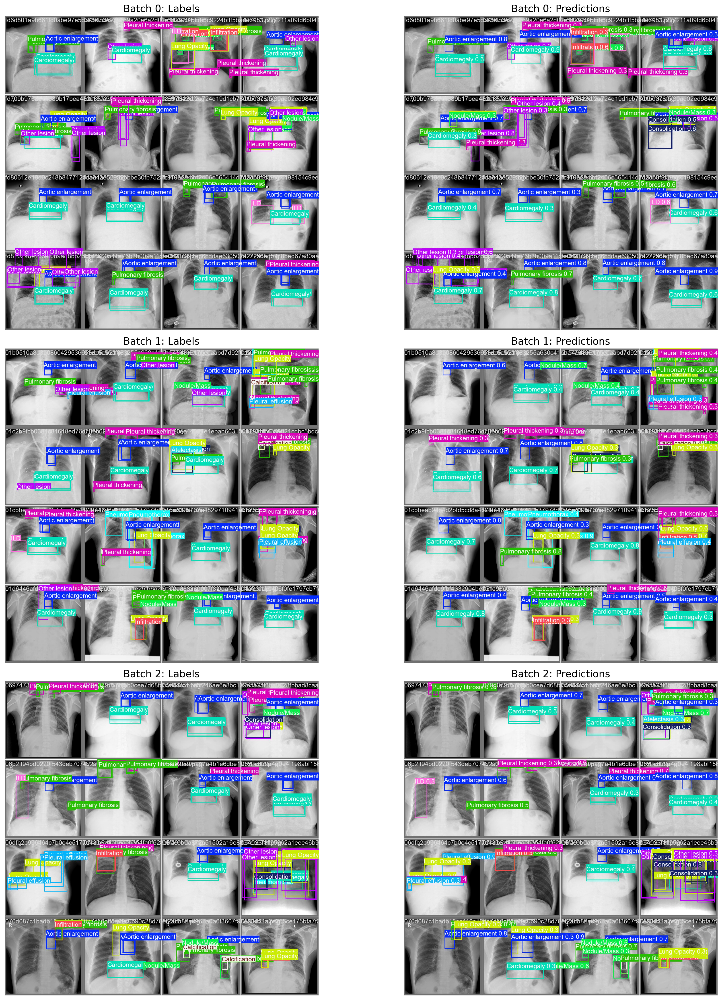

In [24]:
show_val_batch_comparisons(
    dir_path="runs/detect/train",
    max_batches=6,          # for example
    dpi=200,                # even sharper
    width_per_image=10.0,   # wider
    height_per_image=7.5    # taller
)


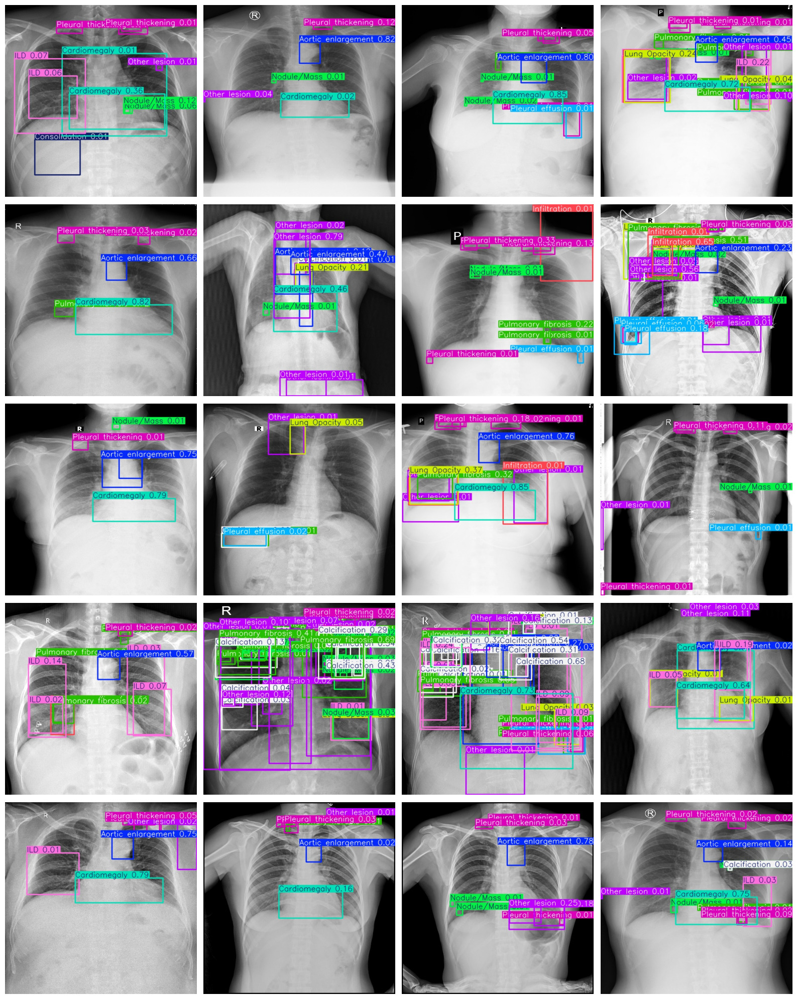

In [25]:
import os
import matplotlib.pyplot as plt
from PIL import Image

# 1. Point to your YOLO output directory
output_dir = "/kaggle/working/runs/detect/exp"

# 2. Gather all .jpg/.png files
images = [
    os.path.join(output_dir, f)
    for f in sorted(os.listdir(output_dir))
    if f.lower().endswith((".jpg", ".png"))
]

# 3. Display the first 20 results in a 5×4 grid
fig, axes = plt.subplots(5, 4, figsize=(16, 20))  # 5 rows, 4 columns
axes = axes.flatten()  # Flatten 2D array of subplots into 1D

for i, img_path in enumerate(images[:20]):
    img = Image.open(img_path)
    axes[i].imshow(img)
    axes[i].axis("off")

# Hide any unused subplots (in case less than 20 images found)
for j in range(i + 1, len(axes)):
    axes[j].axis("off")

plt.tight_layout()
plt.show()